In [323]:
import os
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import GridSearchCV
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.feature_selection import SelectKBest #Feature Selector
from sklearn.feature_selection import f_classif #F-ratio statistic for categorical values
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier as MLP
from sklearn.model_selection import cross_val_score

Load training data

In [324]:
train_df = pd.read_csv(r"D:\Ineuron\Projects\FetalHealthPrediction\Code\FetalHealthPrediction\Datasets\ZipFiles\training-training-train\train.csv")

In [325]:
train_df.shape

(1700, 22)

In [326]:
train_df.head()

,baseline value,accelerations,fetal_movement,uterine_contractions,light_decelerations,severe_decelerations,prolongued_decelerations,abnormal_short_term_variability,mean_value_of_short_term_variability,percentage_of_time_with_abnormal_long_term_variability,...,histogram_min,histogram_max,histogram_number_of_peaks,histogram_number_of_zeroes,histogram_mode,histogram_mean,histogram_median,histogram_variance,histogram_tendency,fetal_health
0,142.0,0.000,0.000,0.007,0.000,0.0,0.0,58.0,0.4,9.0,...,136.0,156.0,0.0,0.0,148.0,147.0,149.0,1.0,0.0,1.0
1,122.0,0.000,0.000,0.006,0.002,0.0,0.0,27.0,1.4,4.0,...,91.0,144.0,4.0,0.0,126.0,120.0,122.0,6.0,0.0,1.0
2,129.0,0.005,0.003,0.001,0.000,0.0,0.0,34.0,1.7,0.0,...,78.0,196.0,10.0,0.0,137.0,136.0,137.0,6.0,0.0,1.0
3,136.0,0.006,0.000,0.008,0.000,0.0,0.0,45.0,0.8,2.0,...,129.0,158.0,2.0,0.0,144.0,143.0,145.0,1.0,0.0,1.0
4,144.0,0.000,0.000,0.006,0.000,0.0,0.0,32.0,1.0,0.0,...,122.0,160.0,1.0,0.0,150.0,147.0,149.0,2.0,1.0,1.0


In [327]:
train_df.describe()

,baseline value,accelerations,fetal_movement,uterine_contractions,light_decelerations,severe_decelerations,prolongued_decelerations,abnormal_short_term_variability,mean_value_of_short_term_variability,percentage_of_time_with_abnormal_long_term_variability,...,histogram_min,histogram_max,histogram_number_of_peaks,histogram_number_of_zeroes,histogram_mode,histogram_mean,histogram_median,histogram_variance,histogram_tendency,fetal_health
count,1700.000000,1700.000000,1700.000000,1700.000000,1700.000000,1700.000000,1700.000000,1700.000000,1700.000000,1700.000000,...,1700.000000,1700.000000,1700.000000,1700.000000,1700.000000,1700.000000,1700.000000,1700.000000,1700.000000,1700.000000
mean,133.213529,0.003212,0.010211,0.004356,0.001899,0.000004,0.000158,46.508824,1.345353,9.738235,...,93.121176,163.842353,4.088824,0.324118,137.128235,134.461176,137.862941,19.046471,0.324706,1.304706
std,9.873344,0.003888,0.050124,0.002943,0.002976,0.000059,0.000587,17.276801,0.898037,18.227303,...,29.520766,17.651851,2.927774,0.683795,16.608926,15.616890,14.552801,29.575447,0.608340,0.614788
min,106.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,12.000000,0.200000,0.000000,...,50.000000,122.000000,0.000000,0.000000,60.000000,75.000000,77.000000,0.000000,-1.000000,1.000000
25%,126.000000,0.000000,0.000000,0.002000,0.000000,0.000000,0.000000,32.000000,0.700000,0.000000,...,67.000000,152.000000,2.000000,0.000000,129.000000,125.000000,128.000000,2.000000,0.000000,1.000000
50%,133.000000,0.002000,0.000000,0.004000,0.000000,0.000000,0.000000,48.000000,1.200000,0.000000,...,93.000000,162.000000,4.000000,0.000000,139.000000,135.500000,139.000000,7.000000,0.000000,1.000000
75%,140.000000,0.006000,0.003000,0.006000,0.003000,0.000000,0.000000,61.000000,1.700000,11.000000,...,120.000000,174.000000,6.000000,0.000000,148.000000,145.000000,148.000000,24.000000,1.000000,1.000000
max,159.000000,0.019000,0.481000,0.015000,0.015000,0.001000,0.005000,87.000000,7.000000,91.000000,...,159.000000,238.000000,18.000000,10.000000,187.000000,182.000000,186.000000,269.000000,1.000000,3.000000


In [328]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1700 entries, 0 to 1699
Data columns (total 22 columns):
 #   Column                                                  Non-Null Count  Dtype  
---  ------                                                  --------------  -----  
 0   baseline value                                          1700 non-null   float64
 1   accelerations                                           1700 non-null   float64
 2   fetal_movement                                          1700 non-null   float64
 3   uterine_contractions                                    1700 non-null   float64
 4   light_decelerations                                     1700 non-null   float64
 5   severe_decelerations                                    1700 non-null   float64
 6   prolongued_decelerations                                1700 non-null   float64
 7   abnormal_short_term_variability                         1700 non-null   float64
 8   mean_value_of_short_term_variability  

Inference 1: 
1. No missing values
2. No categorical values

In [7]:
! pip install pandas-profiling

In [8]:
from pandas_profiling import ProfileReport
profile = ProfileReport(train_df, title="Pandas Profiling Report")

In [9]:
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Inference 2:

1. No missing values
2. Duplicate rows only .4% and hence can be ignored
3. Few highly correlated columns and hence should check out feature selection.
4. Fetal health has high coorelation with more than one columns.
5. There are few left skewed and right skewed curves.



Assumption 1:
1. Since there are lots of  zeros and correlation between features are high, its assumed that zeros are postive data points.

Check Correlation

In [329]:
numeric_data = train_df.select_dtypes(exclude="object")
numeric_corr = numeric_data.corr()

In [330]:
Num_feature = numeric_corr["fetal_health"].sort_values(ascending=False).head(20).to_frame()

cm = sns.light_palette("#5F9EA0", as_cmap=True)

style = Num_feature.style.background_gradient(cmap=cm)
style

,fetal_health
fetal_health,1.000000
prolongued_decelerations,0.491333
abnormal_short_term_variability,0.472149
percentage_of_time_with_abnormal_long_term_variability,0.423533
histogram_variance,0.207946
baseline value,0.141801
severe_decelerations,0.131882
fetal_movement,0.084339
histogram_min,0.076738
light_decelerations,0.054400


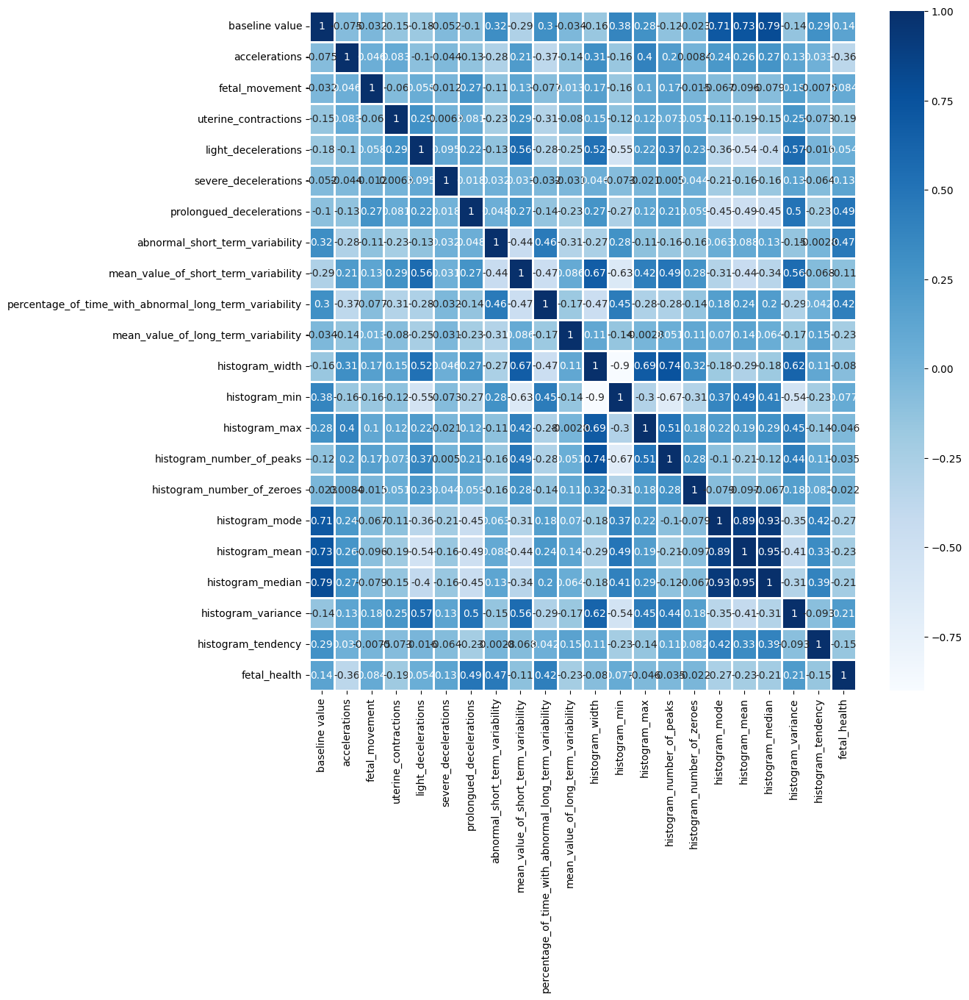

In [331]:
import matplotlib.pyplot as plt
fig, ax=plt.subplots(figsize=(12,12))#Required outside of function. This needs to be activated first when plotting in every code block
plot=sns.heatmap(numeric_corr,annot=True, cmap='Blues', linewidths=1)
plt.show()

Inference 3:
* All the features have some relationship with the output label

In [351]:
all_columns = train_df.columns
all_columns

Index(['baseline value', 'accelerations', 'fetal_movement',
       'uterine_contractions', 'light_decelerations', 'severe_decelerations',
       'prolongued_decelerations', 'abnormal_short_term_variability',
       'mean_value_of_short_term_variability',
       'percentage_of_time_with_abnormal_long_term_variability',
       'mean_value_of_long_term_variability', 'histogram_width',
       'histogram_min', 'histogram_max', 'histogram_number_of_peaks',
       'histogram_number_of_zeroes', 'histogram_mode', 'histogram_mean',
       'histogram_median', 'histogram_variance', 'histogram_tendency',
       'fetal_health'],
      dtype='object')

In [352]:
X_all_columns = all_columns.drop(['fetal_health'])
X_all_columns

Index(['baseline value', 'accelerations', 'fetal_movement',
       'uterine_contractions', 'light_decelerations', 'severe_decelerations',
       'prolongued_decelerations', 'abnormal_short_term_variability',
       'mean_value_of_short_term_variability',
       'percentage_of_time_with_abnormal_long_term_variability',
       'mean_value_of_long_term_variability', 'histogram_width',
       'histogram_min', 'histogram_max', 'histogram_number_of_peaks',
       'histogram_number_of_zeroes', 'histogram_mode', 'histogram_mean',
       'histogram_median', 'histogram_variance', 'histogram_tendency'],
      dtype='object')

In [353]:
X_all = train_df[X_all_columns]

In [354]:
y= train_df["fetal_health"]

Feature Selection

In [355]:
bestfeatures = SelectKBest(score_func=f_classif, k='all')
fit = bestfeatures.fit(X,y)
dfscores = pd.DataFrame(fit.scores_)
dfcolumns = pd.DataFrame(X.columns)
#concat two dataframes for better visualization 
featureScores = pd.concat([dfcolumns,dfscores],axis=1)
featureScores.columns = ['Feature','Score']  #naming the dataframe columns
featureScores.sort_values(by=['Score'], ascending=False, inplace=True)
featureScores

,Feature,Score
6,prolongued_decelerations,416.870520
9,percentage_of_time_with_abnormal_long_term_var...,296.464453
7,abnormal_short_term_variability,274.703840
16,histogram_mode,232.804697
17,histogram_mean,229.452690
18,histogram_median,197.185531
1,accelerations,157.538998
19,histogram_variance,125.258123
0,baseline value,103.291193
8,mean_value_of_short_term_variability,97.142448


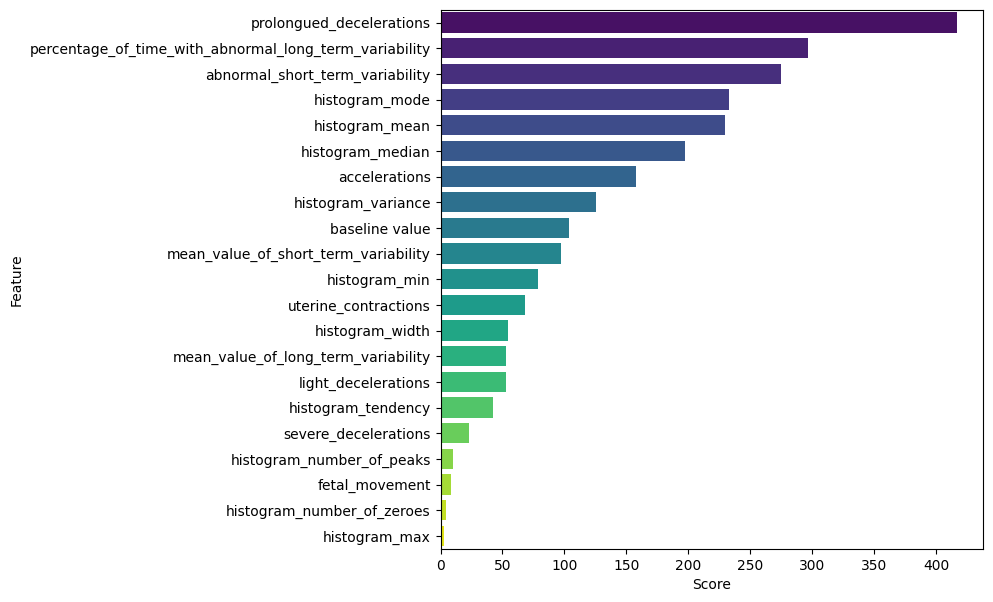

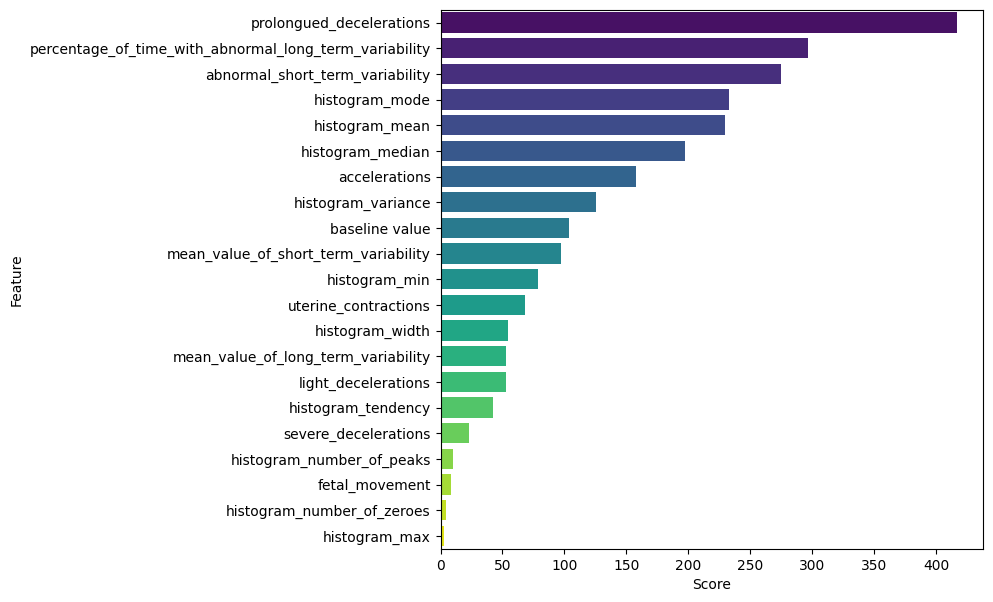

In [358]:
#Visualize the feature scores
fig, ax=plt.subplots(figsize=(7,7))
plot=sns.barplot(data=featureScores, x='Score', y='Feature', palette='viridis',linewidth=0.5, saturation=2, orient='h')
plt.show()

In [359]:
#Selection method score >150
selection=featureScores[featureScores['Score']>=150]
selection=list(selection['Feature'])
selection.append('fetal_health')
select_df=train_df[selection] 
select_df.head()

,prolongued_decelerations,percentage_of_time_with_abnormal_long_term_variability,abnormal_short_term_variability,histogram_mode,histogram_mean,histogram_median,accelerations,fetal_health
0,0.0,9.0,58.0,148.0,147.0,149.0,0.000,1.0
1,0.0,4.0,27.0,126.0,120.0,122.0,0.000,1.0
2,0.0,0.0,34.0,137.0,136.0,137.0,0.005,1.0
3,0.0,2.0,45.0,144.0,143.0,145.0,0.006,1.0
4,0.0,0.0,32.0,150.0,147.0,149.0,0.000,1.0


In [360]:
select_df.describe()

,prolongued_decelerations,percentage_of_time_with_abnormal_long_term_variability,abnormal_short_term_variability,histogram_mode,histogram_mean,histogram_median,accelerations,fetal_health
count,1700.000000,1700.000000,1700.000000,1700.000000,1700.000000,1700.000000,1700.000000,1700.000000
mean,0.000158,9.738235,46.508824,137.128235,134.461176,137.862941,0.003212,1.304706
std,0.000587,18.227303,17.276801,16.608926,15.616890,14.552801,0.003888,0.614788
min,0.000000,0.000000,12.000000,60.000000,75.000000,77.000000,0.000000,1.000000
25%,0.000000,0.000000,32.000000,129.000000,125.000000,128.000000,0.000000,1.000000
50%,0.000000,0.000000,48.000000,139.000000,135.500000,139.000000,0.002000,1.000000
75%,0.000000,11.000000,61.000000,148.000000,145.000000,148.000000,0.006000,1.000000
max,0.005000,91.000000,87.000000,187.000000,182.000000,186.000000,0.019000,3.000000


In [361]:
select_columns = select_df.columns
select_columns

Index(['prolongued_decelerations',
       'percentage_of_time_with_abnormal_long_term_variability',
       'abnormal_short_term_variability', 'histogram_mode', 'histogram_mean',
       'histogram_median', 'accelerations', 'fetal_health'],
      dtype='object')

In [362]:
X_select_columns = select_columns.drop(['fetal_health'])
X_select_columns

Index(['prolongued_decelerations',
       'percentage_of_time_with_abnormal_long_term_variability',
       'abnormal_short_term_variability', 'histogram_mode', 'histogram_mean',
       'histogram_median', 'accelerations'],
      dtype='object')

In [363]:
X_select = select_df[X_select_columns]
X_select.head()

,prolongued_decelerations,percentage_of_time_with_abnormal_long_term_variability,abnormal_short_term_variability,histogram_mode,histogram_mean,histogram_median,accelerations
0,0.0,9.0,58.0,148.0,147.0,149.0,0.000
1,0.0,4.0,27.0,126.0,120.0,122.0,0.000
2,0.0,0.0,34.0,137.0,136.0,137.0,0.005
3,0.0,2.0,45.0,144.0,143.0,145.0,0.006
4,0.0,0.0,32.0,150.0,147.0,149.0,0.000


Split into train and test

In [379]:
X_train_all, X_test_all, y_train, y_test = train_test_split(X_all, y, test_size = 0.3, random_state = 42, stratify = y)

In [380]:
X_train_select, X_test_select, y_train, y_test = train_test_split(X_select, y, test_size = 0.3, random_state = 42, stratify = y)

Scale X

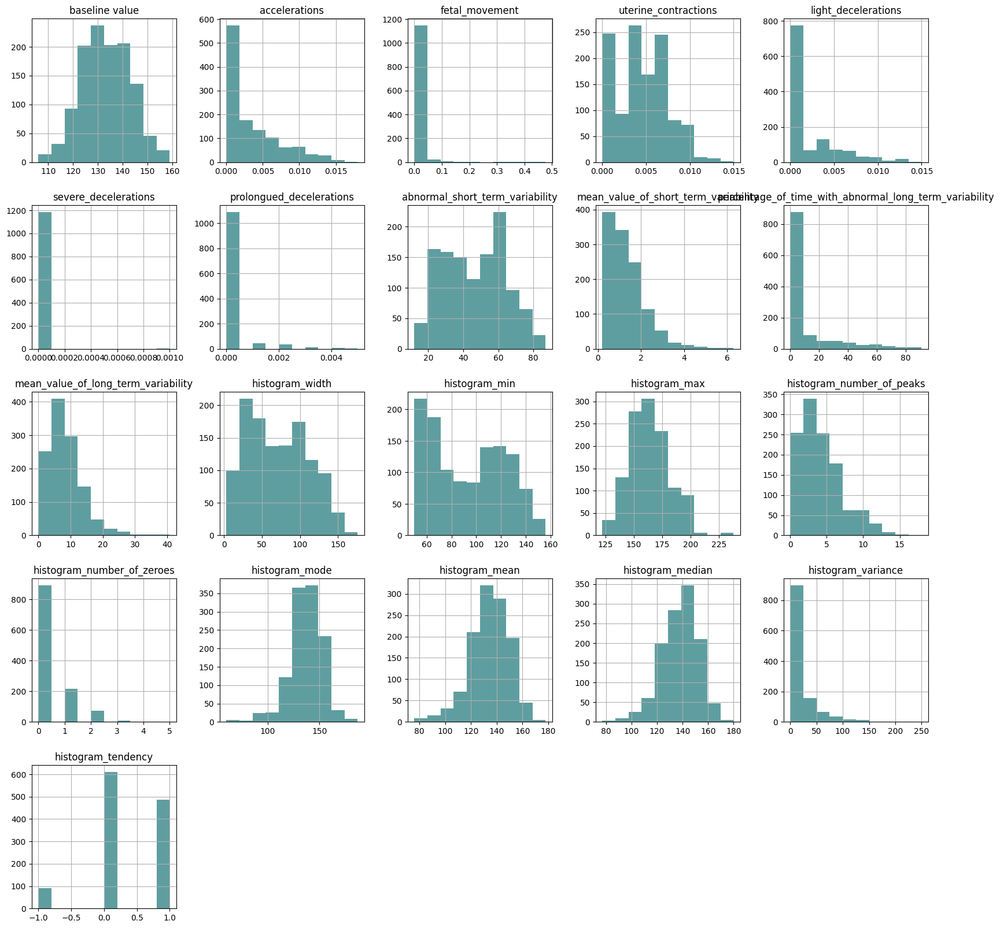

In [381]:
X_hist_plot = X_train_all.hist(figsize = (20,20), color = "#5F9EA0")
plt.show()

In [382]:
scale_all = StandardScaler()
X_train_all_scaled = pd.DataFrame(scale_all.fit_transform(X_train_all),columns=X_all_columns)
X_train_all_scaled.head()

,baseline value,accelerations,fetal_movement,uterine_contractions,light_decelerations,severe_decelerations,prolongued_decelerations,abnormal_short_term_variability,mean_value_of_short_term_variability,percentage_of_time_with_abnormal_long_term_variability,...,histogram_width,histogram_min,histogram_max,histogram_number_of_peaks,histogram_number_of_zeroes,histogram_mode,histogram_mean,histogram_median,histogram_variance,histogram_tendency
0,0.689208,0.711441,-0.180186,-0.118516,-0.302243,-0.064957,-0.266734,-0.308768,0.397440,-0.534049,...,1.288320,-1.384614,0.521681,2.650643,1.025845,1.340292,0.942640,1.111088,0.388358,1.088954
1,0.183375,-0.316316,0.592969,-0.460831,-0.302243,-0.064957,-0.266734,1.071696,0.737124,-0.534049,...,-0.150463,0.102960,-0.159581,-0.373258,-0.515513,0.042129,-0.303667,0.210127,-0.564520,1.088954
2,-1.131791,0.197563,-0.201663,0.223799,-0.638383,-0.064957,-0.266734,-1.229076,0.057756,-0.534049,...,-0.690007,0.373427,-0.897615,-0.037269,-0.515513,-0.699678,-0.631642,-0.760138,-0.564520,-0.541053
3,-0.120125,-0.830194,-0.201663,0.223799,-0.638383,-0.064957,-0.266734,0.151387,0.737124,-0.534049,...,0.466158,-1.046529,-0.727300,0.298720,-0.515513,-0.266957,-0.106881,-0.205701,-0.388061,1.088954
4,1.599708,-0.316316,-0.201663,1.593059,-0.302243,-0.064957,-0.266734,-0.538845,-0.281928,0.003842,...,0.003692,0.373427,0.635224,0.634709,-0.515513,1.587561,1.598591,1.734830,-0.423353,1.088954


In [383]:
X_test_all_scaled = pd.DataFrame(scale_all.transform(X_test_all),columns=X_all_columns)

In [384]:
scale_select = StandardScaler()
X_train_select_scaled = pd.DataFrame(scale_select.fit_transform(X_train_select),columns=X_select_columns)
X_train_select_scaled.head()

,prolongued_decelerations,percentage_of_time_with_abnormal_long_term_variability,abnormal_short_term_variability,histogram_mode,histogram_mean,histogram_median,accelerations
0,-0.266734,-0.534049,-0.308768,1.340292,0.942640,1.111088,0.711441
1,-0.266734,-0.534049,1.071696,0.042129,-0.303667,0.210127,-0.316316
2,-0.266734,-0.534049,-1.229076,-0.699678,-0.631642,-0.760138,0.197563
3,-0.266734,-0.534049,0.151387,-0.266957,-0.106881,-0.205701,-0.830194
4,-0.266734,0.003842,-0.538845,1.587561,1.598591,1.734830,-0.316316


In [385]:
X_test_select_scaled = pd.DataFrame(scale_select.transform(X_test_select),columns=X_select_columns)

Create models

Logistic Regression

In [386]:
lr = LogisticRegression()
lr_model_all = lr.fit(X_train_all_scaled, y_train)
round(lr_model_all.score(X_test_all_scaled, y_test)*100,2)

90.2

In [387]:
lr_model_select = lr.fit(X_train_select_scaled, y_train)
round(lr_model_all.score(X_test_select_scaled, y_test)*100,2)

87.84

Inference:
* Logistic Regression is showing high score if all features are used

KNN model

In [390]:
knn = KNeighborsClassifier()
knn_model_all = knn.fit(X_train_all_scaled, y_train)
round(knn_model_all.score(X_test_all_scaled, y_test)*100,2)

89.8

In [391]:
knn_model_select = knn.fit(X_train_select_scaled, y_train)
round(knn_model_all.score(X_test_select_scaled, y_test)*100,2)

91.96

Inference
* KNN is showing high score if selected features are used

Random Forest (RF)¶


In [404]:
rf = RandomForestClassifier()
rf_model_all = rf.fit(X_train_all_scaled, y_train)
round(rf_model_all.score(X_test_all_scaled, y_test)*100,2)

94.31

In [425]:
rf_model_select = rf.fit(X_train_select_scaled, y_train)
round(rf_model_select.score(X_test_select_scaled, y_test)*100,2)

95.29

Inference:
* Random forest is showing high score when selected features are used

Fine Tuning Random Forest with select features

In [427]:
params_RF = {"min_samples_split": [2, 3, 4],
              "min_samples_leaf": [1, 2, 3, 4, 5],
              "n_estimators" :[100,200,300, 400],
              "criterion": ["gini"]             
              }

In [428]:
GridSearchCV_RF = GridSearchCV(estimator=RandomForestClassifier(), 
                                param_grid=params_RF, 
                                cv=3,
                                verbose=1, 
                                n_jobs=2,
                                scoring="accuracy", 
                                return_train_score=True
                                )

In [429]:
GridSearchCV_RF.fit(X_train_select_scaled, y_train)

Fitting 3 folds for each of 60 candidates, totalling 180 fits


GridSearchCV(cv=3, estimator=RandomForestClassifier(), n_jobs=2,
             param_grid={'criterion': ['gini'],
                         'min_samples_leaf': [1, 2, 3, 4, 5],
                         'min_samples_split': [2, 3, 4],
                         'n_estimators': [100, 200, 300, 400]},
             return_train_score=True, scoring='accuracy', verbose=1)

In [430]:
best_rf_model = GridSearchCV_RF.best_estimator_
best_rf_model

RandomForestClassifier(min_samples_split=3)

In [431]:
round(best_rf_model.score(X_test_select_scaled, y_test)*100,2)

95.69

GradientBoostingClassifier

In [399]:
gbc = GradientBoostingClassifier()
gbc_model_all = gbc.fit(X_train_all_scaled, y_train)
round(gbc_model_all.score(X_test_all_scaled, y_test)*100,2)

96.08

In [400]:
gbc = GradientBoostingClassifier()
gbc_model_select = gbc.fit(X_train_select_scaled, y_train)
round(gbc_model_select.score(X_test_select_scaled, y_test)*100,2)

94.31

Inference:
* GradientBoostingClassifier is showing high score when all features are used

Fine tuning gradient booster with all features

In [432]:
gbc_model_all.get_params()

{'ccp_alpha': 0.0,
 'criterion': 'friedman_mse',
 'init': None,
 'learning_rate': 0.1,
 'loss': 'deviance',
 'max_depth': 3,
 'max_features': None,
 'max_leaf_nodes': None,
 'min_impurity_decrease': 0.0,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.0,
 'n_estimators': 100,
 'n_iter_no_change': None,
 'random_state': None,
 'subsample': 1.0,
 'tol': 0.0001,
 'validation_fraction': 0.1,
 'verbose': 0,
 'warm_start': False}

In [433]:
params_GBC = {"loss": ["deviance"],
              "learning_rate": [0.075, 0.1, 0.25, 0.5,], 
              "n_estimators": [200, 250, 500],
              "max_depth": [3, 5, 8]
              }

In [434]:
GridSearchCV_GBC = GridSearchCV(estimator=GradientBoostingClassifier(), 
                                param_grid=params_GBC, 
                                cv=3,
                                verbose=1, 
                                n_jobs=2,
                                scoring="accuracy", 
                                return_train_score=True
                                )

In [435]:
GridSearchCV_GBC.fit(X_train_all_scaled, y_train)

Fitting 3 folds for each of 36 candidates, totalling 108 fits


GridSearchCV(cv=3, estimator=GradientBoostingClassifier(), n_jobs=2,
             param_grid={'learning_rate': [0.075, 0.1, 0.25, 0.5],
                         'loss': ['deviance'], 'max_depth': [3, 5, 8],
                         'n_estimators': [200, 250, 500]},
             return_train_score=True, scoring='accuracy', verbose=1)

In [436]:
best_gbc_model = GridSearchCV_GBC.best_estimator_
best_gbc_model

GradientBoostingClassifier(learning_rate=0.075, max_depth=5, n_estimators=500)

In [437]:
round(best_gbc_model.score(X_test_all_scaled, y_test)*100,2)

96.08

Comparing average KfoldCV score of GradientBoostingClassifier all and Random Forest Select

In [444]:
# Cross validate random forest score
scores_RF_select = cross_val_score(best_rf_model, X_train_select_scaled, y_train, cv = 3, n_jobs = 2, scoring = "accuracy")
scores_RF_select.mean()

0.9210174795817112

In [445]:
# Cross validate Gradient Boosting Classifier model
scores_gbc_select = cross_val_score(best_gbc_model, X_train_all_scaled, y_train, cv = 3, n_jobs = 2, scoring = "accuracy")
scores_gbc_select.mean()

0.937822812507951

Final Model

In [446]:
best_model = best_gbc_model
scale_model = scale_all

Prediction

Load validation data

In [287]:
valid_df = pd.read_csv(r"D:\Ineuron\Projects\FetalHealthPrediction\Code\FetalHealthPrediction\Datasets\ZipFiles\validation-evaluation-test\test.csv")

In [288]:
valid_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 426 entries, 0 to 425
Data columns (total 21 columns):
 #   Column                                                  Non-Null Count  Dtype  
---  ------                                                  --------------  -----  
 0   baseline value                                          426 non-null    float64
 1   accelerations                                           426 non-null    float64
 2   fetal_movement                                          426 non-null    float64
 3   uterine_contractions                                    426 non-null    float64
 4   light_decelerations                                     426 non-null    float64
 5   severe_decelerations                                    426 non-null    float64
 6   prolongued_decelerations                                426 non-null    float64
 7   abnormal_short_term_variability                         426 non-null    float64
 8   mean_value_of_short_term_variability    

Since y label is not given cannot be used for validating

Load test df

In [289]:
test_df = pd.read_csv(r"D:\Ineuron\Projects\FetalHealthPrediction\Code\FetalHealthPrediction\Datasets\ZipFiles\evaluation-evaluation-test\test.csv")

In [290]:
test_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 426 entries, 0 to 425
Data columns (total 21 columns):
 #   Column                                                  Non-Null Count  Dtype  
---  ------                                                  --------------  -----  
 0   baseline value                                          426 non-null    float64
 1   accelerations                                           426 non-null    float64
 2   fetal_movement                                          426 non-null    float64
 3   uterine_contractions                                    426 non-null    float64
 4   light_decelerations                                     426 non-null    float64
 5   severe_decelerations                                    426 non-null    float64
 6   prolongued_decelerations                                426 non-null    float64
 7   abnormal_short_term_variability                         426 non-null    float64
 8   mean_value_of_short_term_variability    

Output

In [448]:
X_test_input_scaled = pd.DataFrame(scale_all.transform(test_df),columns=X_all_columns)

In [451]:
result = best_model.predict(X_test_input_scaled)
result_df = pd.DataFrame(result, columns=['fetal_health'])
result_df.head()

,fetal_health
0,1.0
1,1.0
2,1.0
3,1.0
4,3.0


In [452]:
result_df.to_csv('output.csv', index=False)